### For the best experience, view this notebook on nbviewer:
[Open in nbviewer](https://nbviewer.org/github/ArturKosma/Learning/blob/main/jupyter/ai_for_games/exercises_3.1-3.5.ipynb)

In [1]:
import leqanimlib
import leqmath
import numpy as np

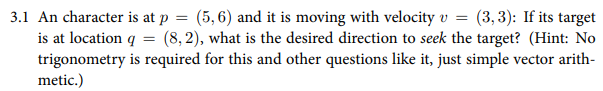

In [2]:
ex3_1 = leqanimlib.leqanimlib(xlim_max=20, ylim_max=20, title='Seek Direction')

p = np.array([5, 6], dtype=float)
v = np.array([3, 3], dtype=float)
q = np.array([8, 2], dtype=float)

character = ex3_1.add_object(ex3_1.Dot(p, 0, display_name='character'))
character.set_vel(v)

target = ex3_1.add_object(ex3_1.Dot(q, 0, display_name='target'))
target.set_arrow_enabled(False)
target.set_color('red')

seek_arrow = ex3_1.add_object(ex3_1.Arrow(character.pos, 0))
seek_arrow.set_color('red')
seek_arrow.rotate_mode = leqanimlib.leqanimlib.BaseObject.RotateMode.ROT_MANUAL

def tick_ex3_1(t):

    seek_dir = target.pos - character.pos # This is the seek direction. Usually direction should also be normalized.
    seek_dir_angle = leqmath.leqmath.dir_to_angle(seek_dir[0], seek_dir[1])
    
    seek_arrow.set_pos(character.pos)
    seek_arrow.set_angle(seek_dir_angle)

ex3_1.draw(tick_ex3_1)

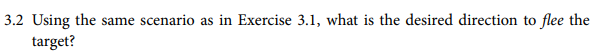

In [3]:
ex3_1.set_title('Flee Direction')
ex3_1.reset_time()

character.set_pos(p)

def tick_ex3_2(t):

    seek_dir = target.pos - character.pos
    flee_dir = seek_dir * -1 # For flee we simply invert the seek direction.
    flee_dir_angle = leqmath.leqmath.dir_to_angle(flee_dir[0], flee_dir[1])
    
    seek_arrow.set_pos(character.pos)
    seek_arrow.set_angle(flee_dir_angle)

ex3_1.draw(tick_ex3_2)

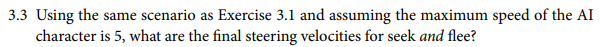

In [4]:
ex3_3 = leqanimlib.leqanimlib(xlim_max=20, ylim_max=20, title='Seek Steering')

character = ex3_3.add_object(ex3_3.Dot(p, 0, display_name='character'))
character.transform_text_velocity = True

target = ex3_3.add_object(ex3_3.Dot(q, 0, display_name='target'))
target.set_arrow_enabled(False)
target.set_color('red')

vel_seek = target.pos - character.pos
vel_seek /= np.linalg.norm(vel_seek) # Normalize before scaling to max speed.
vel_seek *= 5 # Make it max speed.

# vel_seek is the velocity for seeking.
print(vel_seek)

character.set_vel(vel_seek)

def tick_ex3_3(t):

    return

ex3_3.draw(tick_ex3_3)

[ 3. -4.]


In [5]:
ex3_3.set_title('Flee Steering')
ex3_3.reset_time()

vel_flee = vel_seek * -1

# vel_flee is the velocity for fleeing.
print(vel_flee)

character.set_pos(p)
character.set_vel(vel_flee)

def tick_ex3_3flee(t):

    return

ex3_3.draw(tick_ex3_3flee)

[-3.  4.]


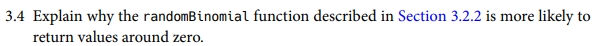

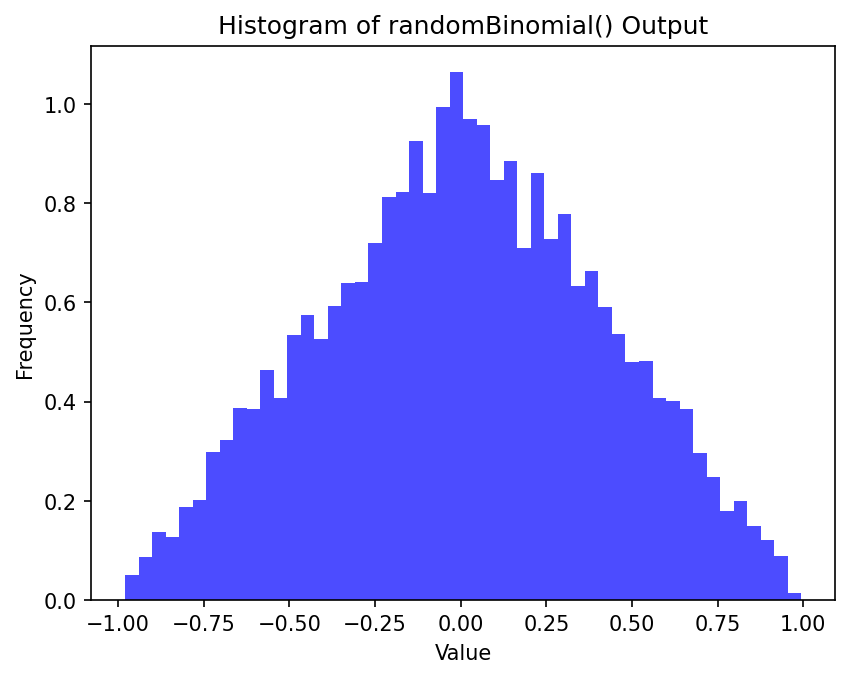

In [6]:
import random
import matplotlib.pyplot as plt

def randomBinomial() -> float:
    return random.random() - random.random()

randoms = np.array([randomBinomial() for _ in range(10000)])

# Plot the histogram
plt.hist(randoms, bins=50, density=True, alpha=0.7, color='blue')
plt.title('Histogram of randomBinomial() Output')
plt.xlabel('Value')
plt.ylabel('Frequency')
plt.show()

#### When we substract one random number <0, 1> from another, the resulting distribution has a peak at 0. The substraction is key here. There are many more ways for A and B to be similar in values than for them to be very different. Thus there is more results close to 0.

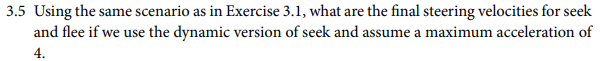

In [7]:
ex3_3.set_title('Dynamic Seek')
ex3_3.reset_time()

character.set_pos(p)
character.set_vel(np.array([3, 3], dtype=float))

def tick_ex3_5(t):

    char_vel = character.vel

    # Find direction.
    vel_seek = target.pos - character.pos
    dir_seek = vel_seek / np.linalg.norm(vel_seek)

    # Acceleration accumulates in velocity.
    char_vel += dir_seek * 4 * ex3_3.delta_time

    # Clamp to max speed.
    current_speed = np.linalg.norm(char_vel)
    if current_speed > 5:
        char_vel /= current_speed
        char_vel *= 5

    character.set_vel(char_vel)

ex3_3.draw(tick_ex3_5)

In [8]:
ex3_3.set_title('Dynamic Flee')
ex3_3.reset_time()

character.set_pos(p)
character.set_vel(np.array([3, 3], dtype=float))

def tick_ex3_5(t):

    char_vel = character.vel

    vel_seek = target.pos - character.pos
    dir_seek = vel_seek / np.linalg.norm(vel_seek) * -1 # We just invert direction.

    char_vel += dir_seek * 4 * ex3_3.delta_time

    # Clamp to max speed.
    current_speed = np.linalg.norm(char_vel)
    if current_speed > 5:
        char_vel /= current_speed
        char_vel *= 5

    character.set_vel(char_vel)

ex3_3.draw(tick_ex3_5)